<a href="https://colab.research.google.com/github/pachterlab/CWGFLHGCCHAP_2021/blob/master/notebooks/Preprocessing/cDNAFiltering/filterStarvCells_ClickTags.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!date

Sat Dec  5 00:33:19 UTC 2020


In [1]:
import requests
from tqdm import tnrange, tqdm_notebook
def download_file(doi,ext):
    url = 'https://api.datacite.org/dois/'+doi+'/media'
    r = requests.get(url).json()
    netcdf_url = r['data'][0]['attributes']['url']
    r = requests.get(netcdf_url,stream=True)
    #Set file name
    fname = doi.split('/')[-1]+ext
    #Download file with progress bar
    if r.status_code == 403:
        print("File Unavailable")
    if 'content-length' not in r.headers:
        print("Did not get file")
    else:
        with open(fname, 'wb') as f:
            total_length = int(r.headers.get('content-length'))
            pbar = tnrange(int(total_length/1024), unit="B")
            for chunk in r.iter_content(chunk_size=1024):
                if chunk:
                    pbar.update()
                    f.write(chunk)
        return fname

In [2]:
#From CellRanger
#matrix
#!wget --quiet https://caltech.box.com/shared/static/htmle5s6wgfv2anq0v51y22mrhbkhy3t
download_file('10.22002/D1.1802','.gz')

#features
#!wget --quiet https://caltech.box.com/shared/static/rohgn56dm1wyf9tzfch30h7ffbe1vdsq
download_file('10.22002/D1.1803','.gz')

#barcodes
#!wget --quiet https://caltech.box.com/shared/static/e0ygaii823rhp0b2qk0l99eoc65dej5k
download_file('10.22002/D1.1801','.gz')

#ClickTag lane 1 counts
#!wget --quiet https://caltech.box.com/shared/static/jyrbkc6iqp8xibcpe4ke58aqq0187iry
download_file('10.22002/D1.1799','.gz')

#ClickTag lane 2 counts
#!wget --quiet https://caltech.box.com/shared/static/i2l24veql2vlkq6jk2arhdwek74bdspl
download_file('10.22002/D1.1800','.gz')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


'D1.1800.gz'

In [3]:
!gunzip *.gz

In [4]:
!pip install --quiet anndata
!pip install --quiet scanpy
!pip3 install --quiet leidenalg
!pip install --quiet louvain

     |████████████████████████████████| 122kB 4.3MB/s 
     |████████████████████████████████| 7.7MB 3.9MB/s 
     |████████████████████████████████| 71kB 9.4MB/s 
     |████████████████████████████████| 51kB 7.1MB/s 
     |████████████████████████████████| 2.4MB 4.3MB/s 
     |████████████████████████████████| 3.2MB 43.5MB/s 
     |████████████████████████████████| 2.2MB 4.4MB/s 


In [5]:
import pandas as pd
import anndata
import scanpy as sc
import numpy as np
import scipy.sparse

import warnings
warnings.filterwarnings('ignore')

from sklearn.neighbors import (KNeighborsClassifier,NeighborhoodComponentsAnalysis)
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.preprocessing import scale

import random

# import scrublet as scr

import matplotlib.pyplot as plt
%matplotlib inline
sc.set_figure_params(dpi=125)

import seaborn as sns
sns.set(style="whitegrid")
%load_ext rpy2.ipython

In [6]:
path = "" #/home/jgehring/scRNAseq/clytia/20181229/jelly3_aggr_20181231/outs/raw_feature_bc_matrix/
!mv D1.1802 D1.1802.mtx
!mv D1.1803 D1.1803.tsv
!mv D1.1801 D1.1801.tsv

jelly3trin = sc.read(path+'D1.1802.mtx', cache=True).T
jelly3trin.var_names = pd.read_csv(path+'D1.1803.tsv', header=None, sep='\t')[1]
jelly3trin.obs_names = pd.read_csv(path+'D1.1801.tsv', header=None)[0]
jelly3trin

AnnData object with n_obs × n_vars = 1474560 × 46716

In [7]:
jelly3trin.var_names_make_unique()
sc.pp.filter_cells(jelly3trin,min_counts=1)
jelly3trin.obs['n_countslog']=np.log10(jelly3trin.obs['n_counts'])


In [8]:
jelly3trin

AnnData object with n_obs × n_vars = 882404 × 46716
    obs: 'n_counts', 'n_countslog'

Analysis for sets of tag reads

In [9]:
!mv D1.1799 tag1_counts.csv
adata = sc.read_csv("tag1_counts.csv")
adata=adata.transpose()

sc.pp.filter_cells(adata, min_counts=100)
adata.obs['n_countslog'] = np.log(adata.obs['n_counts'])

sc.pp.log1p(adata)

#For visualization of tag counts
sc.tl.pca(adata)
sc.tl.tsne(adata)
sc.pp.neighbors(adata)
sc.tl.louvain(adata, resolution=0.35)



In [10]:
sc.tl.louvain(adata, resolution=0.35)

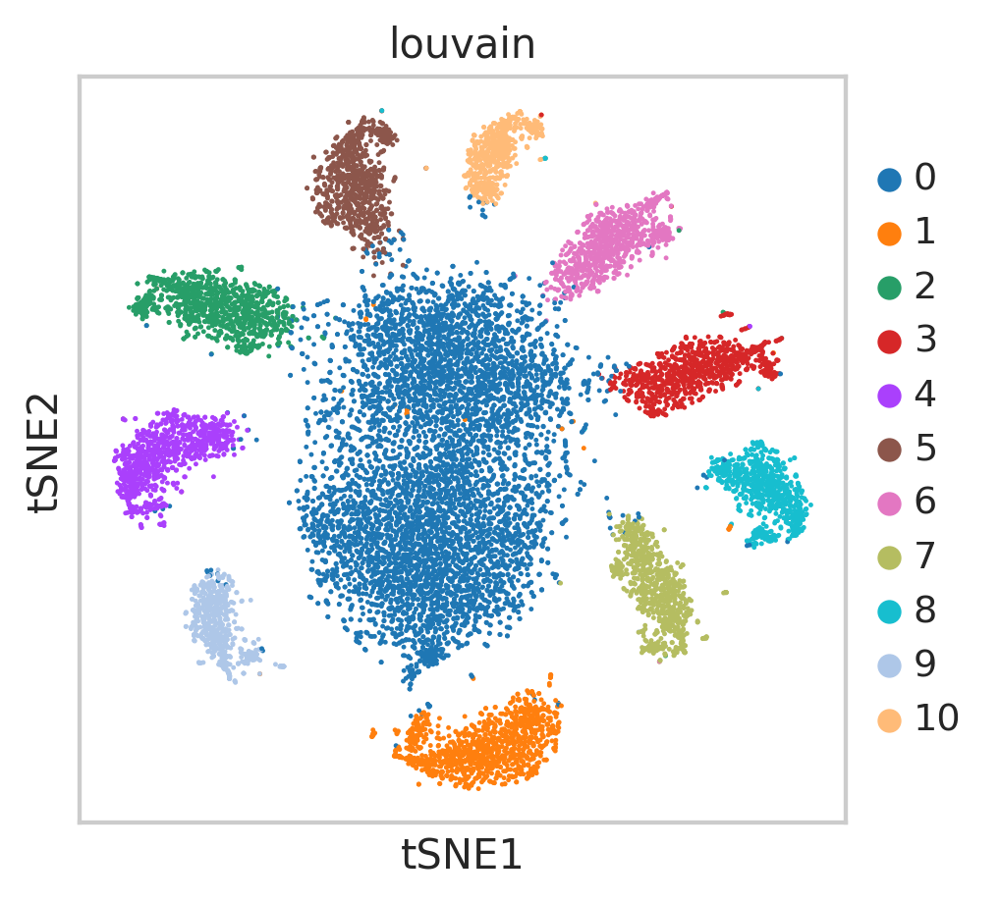

In [11]:
sc.pl.tsne(adata, color=['louvain'])

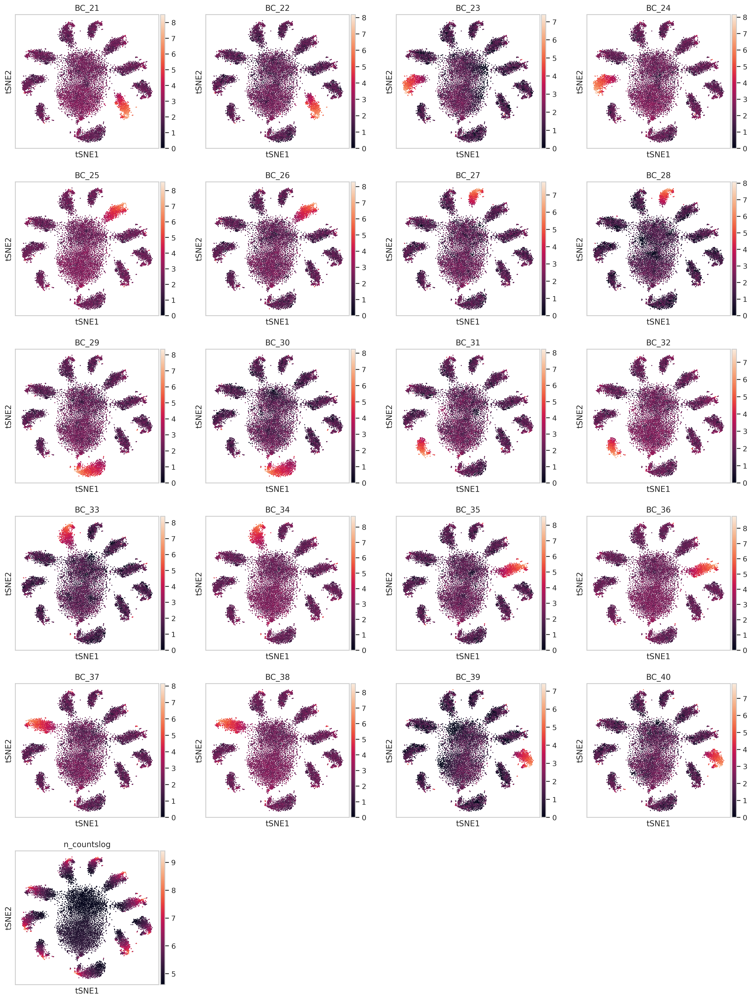

In [ ]:
sc.pl.tsne(adata, color=['BC_21', 'BC_22','BC_23','BC_24','BC_25','BC_26','BC_27','BC_28','BC_29','BC_30','BC_31','BC_32','BC_33',
                         'BC_34', 'BC_35','BC_36','BC_37','BC_38','BC_39','BC_40','n_countslog'])

In [ ]:
!mv D1.1800 tag2_counts.csv
adata2 = sc.read_csv("tag2_counts.csv")
adata2=adata2.transpose()

sc.pp.filter_cells(adata2, min_counts=80)
adata2.obs['n_countslog'] = np.log(adata2.obs['n_counts'])

sc.pp.log1p(adata2)

#For visualization of tag counts
sc.tl.pca(adata2)
sc.tl.tsne(adata2)
sc.pp.neighbors(adata2)
sc.tl.louvain(adata2, resolution=0.35)

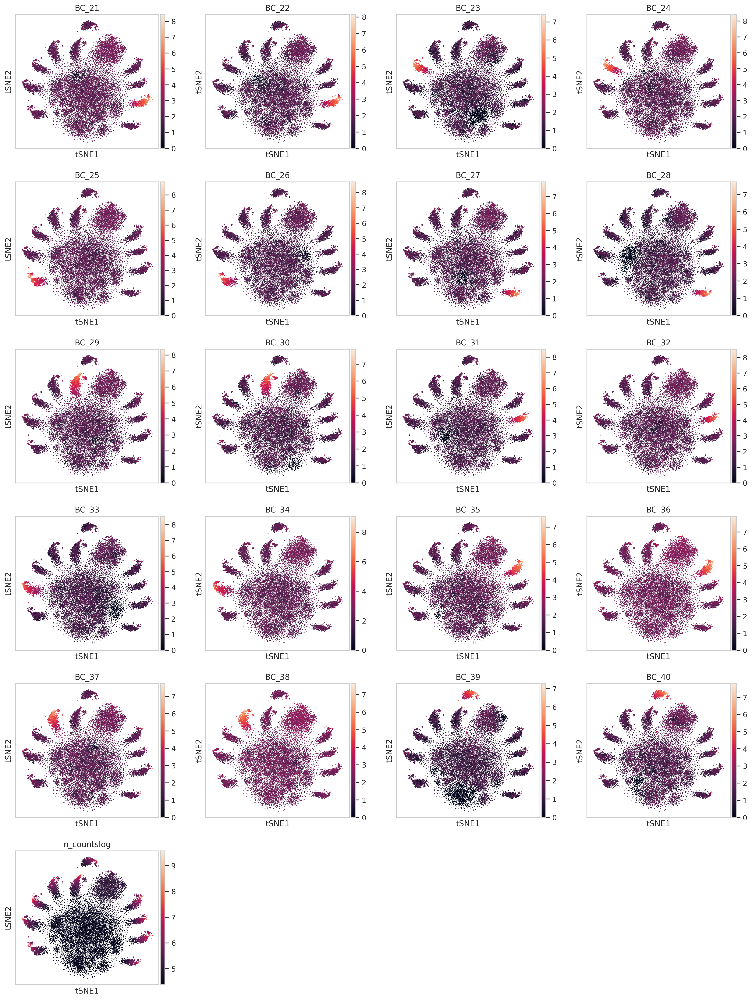

In [ ]:
sc.pl.tsne(adata2, color=['BC_21', 'BC_22','BC_23','BC_24','BC_25','BC_26','BC_27','BC_28','BC_29','BC_30','BC_31','BC_32','BC_33',
                         'BC_34', 'BC_35','BC_36','BC_37','BC_38','BC_39','BC_40','n_countslog'])

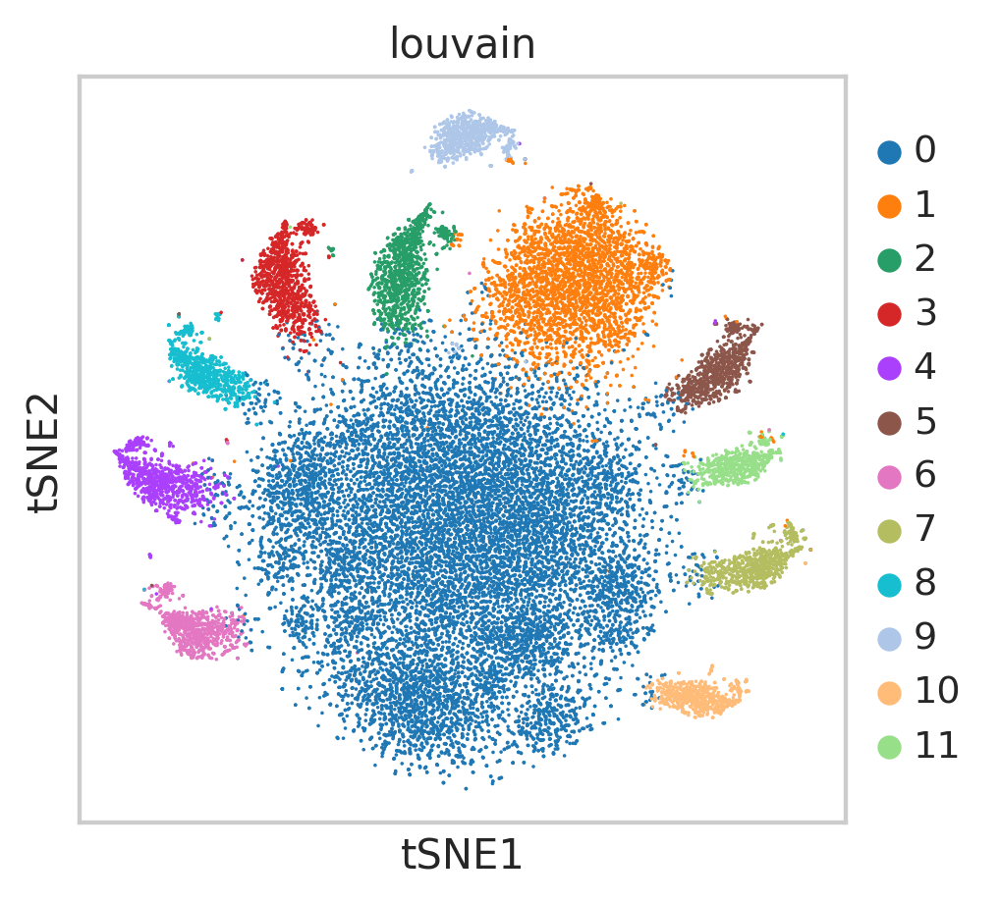

In [ ]:
sc.pl.tsne(adata2,color=['louvain'])

In [ ]:
#Make names unique (For each lane)
adata.obs_names=adata.obs_names+['-1']
adata2.obs_names=adata2.obs_names+['-2']

In [ ]:
#Based on tsne Plots assign organism IDs/numbers from experiment (1 - 10 jellies)

adataorgIDdict={'7':'1', '4':'2', '6':'3','10':'4', '1':'5', '9':'6', '5':'7', '3':'8', '2':'9', '8':'10' }
adata.obs['filtered_by_oligos'] = adata.obs['louvain'].isin(['3','4','8','7','5','2','9','10','6','11'])


adata2orgIDdict={'8':'2', '5':'8', '7':'1','11':'6', '2':'5', '10':'4', '6':'3', '4':'7', '3':'9', '9':'10', 'louvain':'org'}
adata2.obs['filtered_by_oligos'] = adata2.obs['louvain'].isin(['2','3','4','7','5','9','10','6','11','8'])


In [ ]:
HDfilteradata = adata[adata.obs['louvain'].isin(['3','4','8','7','5','2','9','10','6','1'])]
HDfilteradata2 = adata2[adata2.obs['louvain'].isin(['2','3','4','7','5','9','10','6','11','8'])]

HDfilteradata.obs['orgID']=[adataorgIDdict.get(x) for x in list(HDfilteradata.obs['louvain'])]
HDfilteradata2.obs['orgID']=[adata2orgIDdict.get(x) for x in list(HDfilteradata2.obs['louvain'])]

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


In [ ]:
ojelly3trin=jelly3trin[jelly3trin.obs_names.isin(list(HDfilteradata.obs_names)+list(HDfilteradata2.obs_names))]
sc.pp.filter_cells(ojelly3trin, min_counts=0)

View of AnnData object with n_obs × n_vars = 16818 × 46716
    obs: 'n_counts', 'n_countslog'

In [ ]:
holder=pd.DataFrame()
#I need to make dictionaries to map the organismIDs from both 10x lanes back to my experimental conditions
for cell in list(ojelly3trin.obs_names):
    if cell[-1:]=='1':
        holder[cell]=[list(HDfilteradata.obs['orgID'])[list(HDfilteradata.obs_names).index(cell)]]
    elif cell[-1:]=='2':
        holder[cell]=[list(HDfilteradata2.obs['orgID'])[list(HDfilteradata2.obs_names).index(cell)]]

In [ ]:
holder.head()

,AAACCTGAGAGGGCTT-1,AAACCTGAGAGGTTAT-1,AAACCTGAGCGAGAAA-1,AAACCTGAGCGTGTCC-1,AAACCTGAGGATTCGG-1,AAACCTGAGGTGATAT-1,AAACCTGCAAAGTGCG-1,AAACCTGCAAGCTGGA-1,AAACCTGCAATCACAC-1,AAACCTGCATAACCTG-1,AAACCTGCATGCAACT-1,AAACCTGCATGCAATC-1,AAACCTGGTACATGTC-1,AAACCTGGTAGTACCT-1,AAACCTGGTCAGGACA-1,AAACCTGGTCGGCACT-1,AAACCTGGTCGGCTCA-1,AAACCTGGTCTTCTCG-1,AAACCTGGTGCAGTAG-1,AAACCTGTCAACTCTT-1,AAACCTGTCAGAAATG-1,AAACCTGTCAGGTTCA-1,AAACCTGTCATATCGG-1,AAACCTGTCCTAGTGA-1,AAACCTGTCGGAAATA-1,AAACCTGTCGGATGGA-1,AAACCTGTCTCTAGGA-1,AAACGGGAGCTGCCCA-1,AAACGGGAGTGAACAT-1,AAACGGGCAAACCCAT-1,AAACGGGCAAAGCAAT-1,AAACGGGGTCATATCG-1,AAACGGGGTCCTGCTT-1,AAACGGGGTGCATCTA-1,AAACGGGGTTCCGTCT-1,AAACGGGGTTCGTGAT-1,AAACGGGTCATTGCCC-1,AAACGGGTCCACTGGG-1,AAACGGGTCTAACGGT-1,AAACGGGTCTGACCTC-1,...,TTTGCGCGTATATGAG-2,TTTGCGCGTCCAGTAT-2,TTTGCGCGTCCTCTTG-2,TTTGCGCGTCTTGATG-2,TTTGCGCGTTATCCGA-2,TTTGCGCGTTGGTAAA-2,TTTGCGCTCAACCAAC-2,TTTGCGCTCAGCTGGC-2,TTTGCGCTCAGTCAGT-2,TTTGCGCTCGCCCTTA-2,TTTGCGCTCTTAGCCC-2,TTTGGTTAGACTAGAT-2,TTTGGTTAGCGCCTTG-2,TTTGGTTAGCTAACAA-2,TTTGGTTAGGACTGGT-2,TTTGGTTCACAACGCC-2,TTTGGTTCACAAGCCC-2,TTTGGTTCAGCCAATT-2,TTTGGTTCATTCACTT-2,TTTGGTTGTCGAGATG-2,TTTGGTTGTGTATGGG-2,TTTGGTTTCAGTGCAT-2,TTTGGTTTCCAAGCCG-2,TTTGGTTTCCCGGATG-2,TTTGTCAAGAGATGAG-2,TTTGTCAAGCAGGTCA-2,TTTGTCAAGGGCATGT-2,TTTGTCACAAACGCGA-2,TTTGTCACACTCTGTC-2,TTTGTCACACTTAACG-2,TTTGTCACAGAAGCAC-2,TTTGTCAGTACCTACA-2,TTTGTCAGTATGGTTC-2,TTTGTCAGTCATTAGC-2,TTTGTCAGTCTCCACT-2,TTTGTCAGTGGACGAT-2,TTTGTCATCATCTGTT-2,TTTGTCATCGCCTGAG-2,TTTGTCATCTAACGGT-2,TTTGTCATCTGAGTGT-2
0,3,9,3,10,8,7,6,7,9,3,4,5,9,5,9,9,5,6,4,8,2,9,2,7,5,2,9,10,1,9,3,2,1,9,5,1,1,10,3,9,...,5,7,2,2,7,7,3,8,10,2,4,2,3,9,10,9,5,5,7,9,4,6,10,10,2,10,7,5,9,7,4,5,4,7,9,4,7,7,3,9


In [ ]:
import copy
ojelly3trin.obs['temp']=holder.iloc[0]
ojelly3trin.obs['orgID']=copy.deepcopy(ojelly3trin.obs['temp'])

In [ ]:
#Color by Condition Labels
ojelly3trin.obs['fed']=ojelly3trin.obs['orgID'].isin(['1','2', '3', '4', '5'])

ojelly3trin.obs['starved']=ojelly3trin.obs['orgID'].isin(['6','7', '8', '9', '10'])

In [ ]:
ojelly3trin.write('jelly3trin_conditions.h5ad')
pd.DataFrame(ojelly3trin.obs_names).to_csv("jelly3trin_barcodes.csv", index=None)


... storing 'temp' as categorical
... storing 'orgID' as categorical
